# Testing RGB Transformation Data Augmentation
<a id='top'></a>

Data augmentation is crucial for improving results in virtually all cases of computer vision tasks. This notebook was used to test a number of RGB transformations to explore their usefulness in improving the accuracy of a test dataset.

### Setup
All experiments were carried out using a ResNet152 model trained for 40 epochs on the Stanford Cars dataset using a Paperspace P6000 machine. Each test was run 5 times\* and the validation accuraies were then averaged. Fastai's default set of data augmentations ([get_transforms()](https://docs.fast.ai/vision.transform.html#get_transforms)) was also used in every experiment.

The default *get_tranforms()* parameters were used:
```
get_transforms(do_flip:bool=True, flip_vert:bool=False, max_rotate:float=10.0, 
    max_zoom:float=1.1, max_lighting:float=0.2, max_warp:float=0.2, p_affine:float=0.75, 
    p_lighting:float=0.75)
```
\*the baseline test was only run 3 times due to time constraints

### RGB Functions Tested:
3 different types of RGB transformations were tested, including one from the Fastai library

- **rgb_tweak** - randomly set a random channel to zeros, set the probablilty that a tranformation will occur

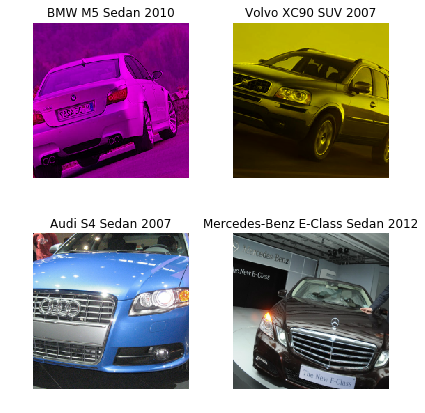

In [13]:
data, src, car_tfms = get_data(rgb_tweak(t=0.5))
data.show_batch(rows=2, figsize=(6,6))

- **rgb_tweak_rand** - randomly set a random channel to noise, set the probablilty that a tranformation will occur

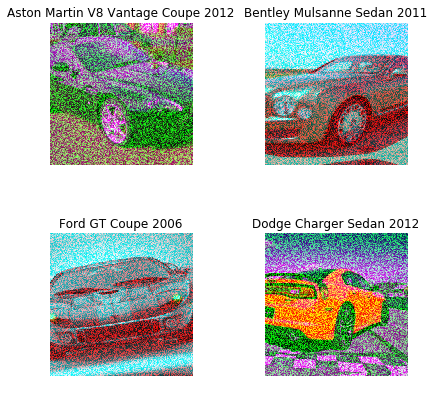

In [14]:
data, src, car_tfms = get_data(rgb_tweak_rand(t=0.5))
data.show_batch(rows=2, figsize=(6,6))

- **[rgb_randomize](https://docs.fast.ai/vision.transform.html#_rgb_randomize)** - randomly scale a channel with noise up to a certain threshold, implemented in Fastai's vision transforms library. Set the maximum noise to scale to.

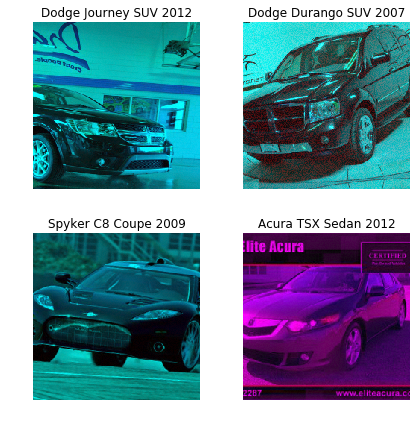

In [20]:
data, src, car_tfms = get_data(rgb_randomize(thresh=0.5))
data.show_batch(rows=2, figsize=(6,6))

### Training Runs Carried Out:
- baseline
- rgb_tweak(t=0.5) 
- rgb_tweak(t=0.75)) 
- rgb_tweak(t=0.99) 
- rgb_tweak_rand(t=0.5)
- rgb_tweak_rand(t=0.3)
- rgb_randomize(thresh=0.3)
- rgb_randomize(thresh=0.5)
- rgb_randomize(thresh=0.8)

### Results:
[Click here to go to the results cell](#results)

Based on average validation accuracy, the `rgb_tweak` transform with a probability of 75% had the strongest performance, followed by the same transform at 99% probability. The noise-based transforms (`rgb_tweak` and `rgb_randomize`) seems to either have no impact or a negative impact on validation accuracy.

Text(23.89,0.5,'Validation Accuracy')

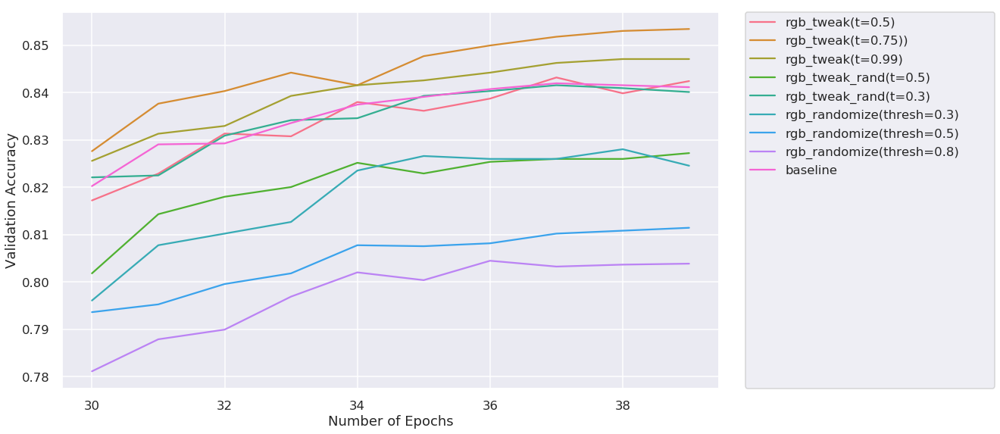

In [46]:
sns.set()
style.use('seaborn-colorblind')
sns.set_context('talk')
fig, ax = pyplot.subplots(figsize=(14,8))
ax = sns.lineplot(data=acc_mean_df, dashes=False)

leg = legend(bbox_to_anchor=(1.04,0.0,0.38,1), loc="lower left",
                borderaxespad=0, mode='expand')

plt.tight_layout(rect=[0,0,1.0,1])

# do this after calling tight layout or changing axes positions in any way:
fontsize = fig.canvas.get_renderer().points_to_pixels(leg._fontsize)
pad = 2 * (leg.borderaxespad + leg.borderpad) * fontsize
leg._legend_box.set_height(leg.get_bbox_to_anchor().height-pad)

xlabel('Number of Epochs')
ylabel('Validation Accuracy')

# Imports

In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

import pandas as pd
from pathlib import Path
import json
from PIL import ImageDraw, ImageFont
import scipy.io as sio

In [2]:
from matplotlib.pyplot import figure, subplot, plot, xlabel, ylabel, title, suptitle, legend, grid, xlim, ylim, savefig
from matplotlib import patches, patheffects
import matplotlib.pyplot as plt
from matplotlib import pyplot 
import matplotlib.style as style 

import seaborn as sns #; sns.set()
import pylab

In [3]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

from fastai import *
from fastai.vision import *
from fastai.utils.mem import *

In [4]:
path = 'data/stanford-cars'

labels_df = pd.read_csv('labels_df.csv')
labels_df.head(3)

,filename,bbox_x1,bbox_y1,bbox_x2,bbox_y2,class_id,class_name,is_test,filename_cropped,bbox_h,bbox_w
0,00001.jpg,39,116,569,375,14,Audi TTS Coupe 2012,0,cropped_00001.jpg,260,531
1,00002.jpg,36,116,868,587,3,Acura TL Sedan 2012,0,cropped_00002.jpg,472,833
2,00003.jpg,85,109,601,381,91,Dodge Dakota Club Cab 2007,0,cropped_00003.jpg,273,517


### Get the data

In [5]:
def get_data(xtra_tfms=[]):
    SZ = 224
    SEED = 42
    LABEL = 'class_name'
    
    car_tfms = get_transforms(xtra_tfms=xtra_tfms)

    trn_labels_df = labels_df.loc[labels_df['is_test']==0, ['filename', 'class_name', 'class_id']].copy()

    src = (ImageList.from_df(trn_labels_df, path, folder='train', cols='filename')
                        .split_by_rand_pct(valid_pct=0.2, seed=SEED)
                        .label_from_df(cols=LABEL))

    data = (src.transform(car_tfms, size=SZ)
                .databunch()
                .normalize(imagenet_stats))
    
    return data, src, car_tfms

## RGB Transforms
#### rgb_tweak - randomly set a random channel to zeros

In [6]:
def _rgb_tweak(x,t:float=0.5):
    "Decide whether to set a random channel to zero"
    rand = torch.rand(1)
    if rand < t:
        rand_channel = torch.rand(1)
        c = 0
        if rand_channel < 0.33:                          c = 0
        elif (rand_channel >= 0.33 and rand_channel < 0.66):c = 1
        else:                                            c = 2
        #x[c] = torch.rand(x.shape[1:])
        x[c] = torch.zeros(x.shape[1:])
    return x
rgb_tweak = TfmPixel(_rgb_tweak)

#### rgb_tweak_rand - randomly set a random channel to noise

In [7]:
def _rgb_tweak_rand(x,t:float=0.5):
    "Decide whether to set a random channel to zero"
    rand = torch.rand(1)
    if rand < t:
        rand_channel = torch.rand(1)
        c = 0
        if rand_channel < 0.33:                          c = 0
        elif (rand_channel >= 0.33 and rand_channel < 0.66):c = 1
        else:                                            c = 2
        x[c] = torch.rand(x.shape[1:])
        #x[c] = torch.zeros(x.shape[1:])
    return x
rgb_tweak_rand = TfmPixel(_rgb_tweak_rand)

#### [fastai] rgb_randomize - scale a channel with noise up to a certain threshold

In [8]:
def _rgb_randomize(x, channel:int=None, thresh:float=0.3):
    "Randomize one of the channels of the input image"
    if channel is None: channel = np.random.randint(0, x.shape[0] - 1)
    x[channel] = torch.rand(x.shape[1:]) * np.random.uniform(0, thresh)
    return x

rgb_randomize = TfmPixel(_rgb_randomize)

# Testing

## 1. GET BASELINE
No RGB transformations, standard fastai transforms from `get_transforms()` used

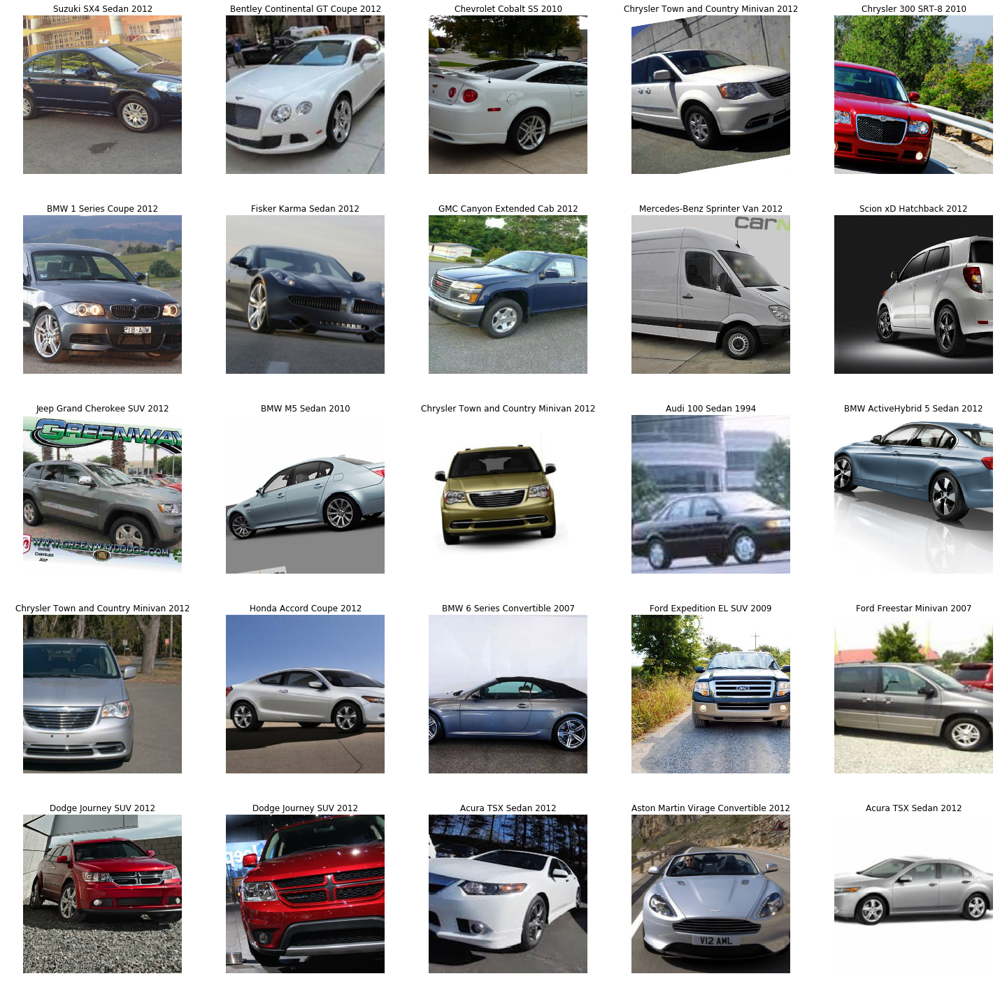

In [ ]:
data, src, car_tfms = get_data()
data.show_batch()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


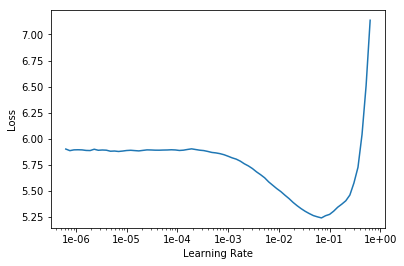

In [ ]:
data, src, car_tfms = get_data()
data.batch_size = 128

arch = models.resnet152

learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])

learn.lr_find()
learn.recorder.plot()

In [5]:
arch = models.resnet152
data, src, car_tfms = get_data()
data.batch_size = 128

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 3 different models so that we can average the validation accuracy
for i in range(0,3):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)
    
    base2_tmp_df = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
    base2_tmp_df.to_csv(f'base2_tmp_{lr}_{i}.csv')

# Save the model and the metrics
learn.save(f'base2_rgb_aug_{lr}_40e')

base2_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
base2_rgb_aug.to_csv(f'base2_rgb_aug_{lr}.csv')

epoch,train_loss,valid_loss,accuracy,time
0,5.215050,4.204959,0.135135,01:20
1,4.236446,3.183086,0.285627,01:10
2,3.306965,2.223860,0.480344,01:10
3,2.443291,1.751909,0.543612,01:11
4,1.862061,1.761894,0.523342,01:10
5,1.570992,2.051164,0.490172,01:10
6,1.509044,2.447797,0.427518,01:10
7,1.521789,2.530898,0.426290,01:10
8,1.501774,3.094728,0.367322,01:09
9,1.456664,2.262763,0.480958,01:10


epoch,train_loss,valid_loss,accuracy,time
0,5.191569,4.234869,0.114251,01:10
1,4.251919,3.220682,0.289926,01:10
2,3.337400,2.302852,0.451474,01:10
3,2.463377,1.779368,0.541155,01:10
4,1.857612,1.947966,0.482801,01:10
5,1.580680,2.307448,0.425061,01:11
6,1.530031,3.021254,0.343980,01:11
7,1.503793,2.754373,0.373464,01:11
8,1.471758,3.088748,0.374079,01:11
9,1.471691,2.029852,0.490172,01:10


epoch,train_loss,valid_loss,accuracy,time
0,5.167625,4.143146,0.144349,01:11
1,4.202101,3.118558,0.318182,01:10
2,3.276091,2.174379,0.494472,01:11
3,2.401498,1.768322,0.535627,01:10
4,1.819627,1.572276,0.589681,01:11
5,1.540425,2.104494,0.466830,01:09
6,1.519714,2.423895,0.438575,01:12
7,1.518405,2.892843,0.367322,01:10
8,1.521458,2.035114,0.503071,01:11
9,1.396022,2.342840,0.447789,01:11


In [6]:
# Tidy up the data for nice plotting
base = base2_rgb_aug.transpose()
tmp_ls = []
acc_ls = []

for i,v in enumerate(base[0]):
    for j in v:
        tmp_ls.append(j[0].numpy().item())
    acc_ls.append(tmp_ls)
    tmp_ls = []
    
base2_acc_df = pd.DataFrame(acc_ls).transpose()
base2_acc_df.to_csv('base2_accuracy.csv')
base2_acc_df.head()

,0,1,2
0,0.135135,0.114251,0.144349
1,0.285627,0.289926,0.318182
2,0.480344,0.451474,0.494472
3,0.543612,0.541155,0.535627
4,0.523342,0.482801,0.589681


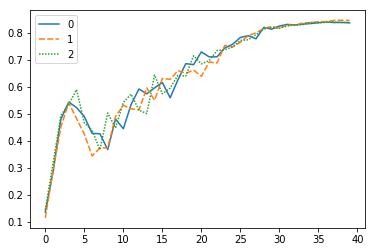

In [7]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=base2_acc_df)

## 2. Test 1: 50% probability of 1 channel being set to zero 

In [11]:
def _rgb_zero(x,t:float=0.5):
    "Decide whether to set a random channel to zero"
    r = torch.rand(1)
    if r > t:
        r_channel = torch.rand(1)
        if r_channel < 0.33:
            c = 0
        elif (r_channel >= 0.33 and r_channel < 0.66):
            c = 1
        else:
            c = 2
        x[c] = torch.zeros(x.shape[1:])
        # x[c] = torch.rand(x.shape[1:])
    return x

rgb_zero = TfmPixel(_rgb_zero)

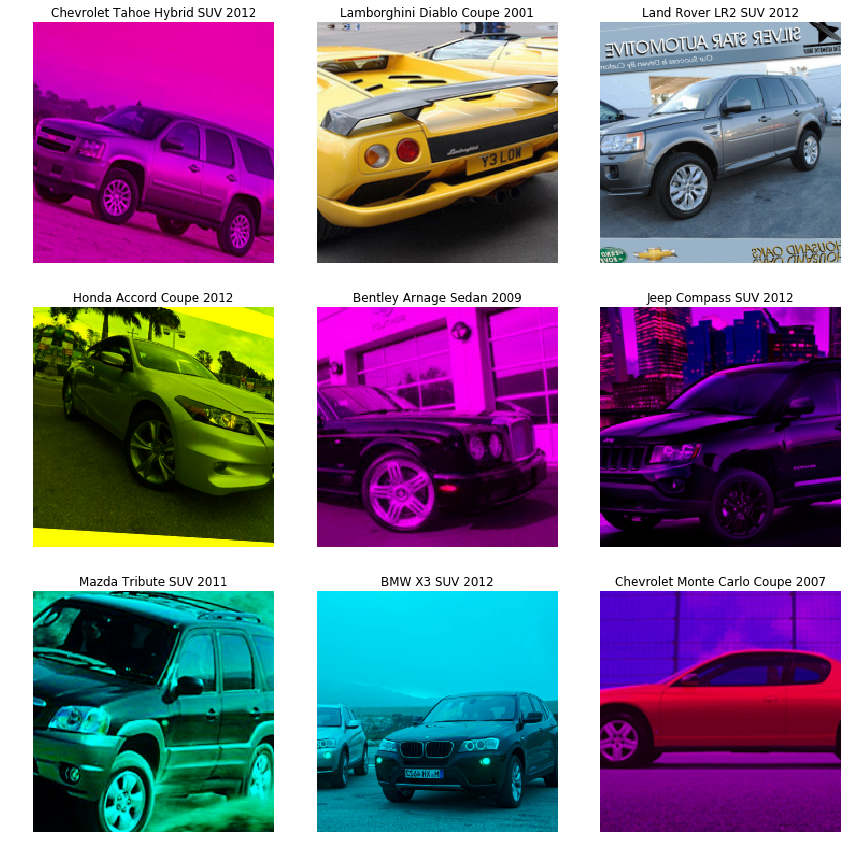

In [12]:
data, src, car_tfms = get_data(rgb_tweak(t=0.5))
data.show_batch(rows=3)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


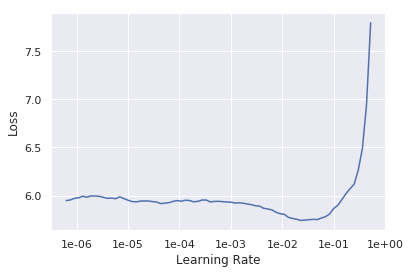

In [18]:
arch = models.resnet152
data.batch_size = 26
learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])

learn.lr_find()
learn.recorder.plot()

In [6]:
arch = models.resnet152
data, src, car_tfms = get_data(rgb_tweak(thresh=0.5))
data.batch_size = 26

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 5 different models so that we can average the validation accuracy
for i in range(0,5):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)

# Save the model and the metrics
learn.save(f't1_p0.5_rgb_aug_{lr}_30e')

t1_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
t1_rgb_aug.to_csv('t1_p0.5_rgb_aug.csv')

epoch,train_loss,valid_loss,accuracy,time
0,4.608905,3.743131,0.189189,02:12
1,3.328625,2.507569,0.439189,02:11
2,2.495664,1.869986,0.507371,02:11
3,2.271827,1.921673,0.492629,02:11
4,2.367054,2.124903,0.441646,02:11
5,2.438826,2.262725,0.447174,02:10
6,2.407444,2.223596,0.436732,02:10
7,2.314145,2.354760,0.387592,02:10
8,2.191713,2.049371,0.477887,02:13
9,2.130593,1.958990,0.487715,02:18


epoch,train_loss,valid_loss,accuracy,time
0,4.568829,3.664551,0.214373,02:14
1,3.334293,2.497404,0.425676,02:14
2,2.523661,1.954700,0.484029,02:13
3,2.185451,2.195283,0.444717,02:13
4,2.366033,2.212614,0.436732,02:13
5,2.448805,2.004927,0.472359,02:13
6,2.431693,2.137892,0.439803,02:13
7,2.329108,2.204168,0.441646,02:12
8,2.193906,2.476499,0.391892,02:12
9,2.146499,1.873085,0.505528,02:12


epoch,train_loss,valid_loss,accuracy,time
0,4.589885,3.733934,0.205160,02:11
1,3.322761,2.474262,0.424447,02:12
2,2.479252,2.009705,0.475430,02:11
3,2.204542,1.874223,0.498771,02:11
4,2.340521,2.237304,0.445332,02:12
5,2.377051,2.041840,0.465602,02:11
6,2.314745,2.242346,0.444717,02:10
7,2.312115,2.075309,0.468059,02:10
8,2.270807,2.129279,0.442875,02:10
9,2.207257,1.968318,0.495700,02:10


epoch,train_loss,valid_loss,accuracy,time
0,4.603745,3.764031,0.195332,02:11
1,3.305405,2.525482,0.412776,02:12
2,2.517527,1.948206,0.510442,02:11
3,2.301285,1.805080,0.515356,02:12
4,2.277503,2.055652,0.483415,02:11
5,2.413443,2.274681,0.436118,02:11
6,2.383328,2.457437,0.375921,02:10
7,2.322166,2.070184,0.456388,02:11
8,2.215911,2.195299,0.434889,02:10
9,2.171926,1.886577,0.510442,02:10


epoch,train_loss,valid_loss,accuracy,time
0,4.603918,3.800700,0.184275,02:12
1,3.412277,2.608486,0.388206,02:11
2,2.567571,1.926390,0.511056,02:11
3,2.299749,1.931440,0.475430,02:11
4,2.271591,2.213840,0.433047,02:11
5,2.459632,2.119697,0.452088,02:10
6,2.315821,2.455040,0.393120,02:11
7,2.393689,2.192664,0.434275,02:10
8,2.240861,2.508464,0.385749,02:10
9,2.146310,2.001542,0.484029,02:10


In [78]:
t1_rgb_aug = pd.read_csv('t1_p0.5_rgb_aug.csv', header=None)
t1_rgb_aug = t1_rgb_aug.iloc[1:,1:].copy()
# Tidy up the data for nice plotting
base = t1_rgb_aug.transpose()
base.columns = ['acc',1,2]

tmp_ls = []
for b in base['acc']:
    tmp_ls.append([float(s) for s in re.findall("\d+\.\d+", b)])
    
t1_acc_df = pd.DataFrame(tmp_ls).transpose()
t1_acc_df.to_csv('t1_p0.5_rgb_aug_accuracy.csv')
t1_acc_df.head()

,0,1,2,3,4
0,0.1892,0.2144,0.2052,0.1953,0.1843
1,0.4392,0.4257,0.4244,0.4128,0.3882
2,0.5074,0.4840,0.4754,0.5104,0.5111
3,0.4926,0.4447,0.4988,0.5154,0.4754
4,0.4416,0.4367,0.4453,0.4834,0.4330


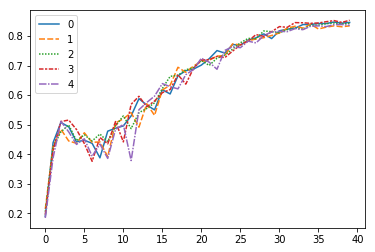

In [74]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=t1_acc_df)

## Test 2. with aug = 0.75

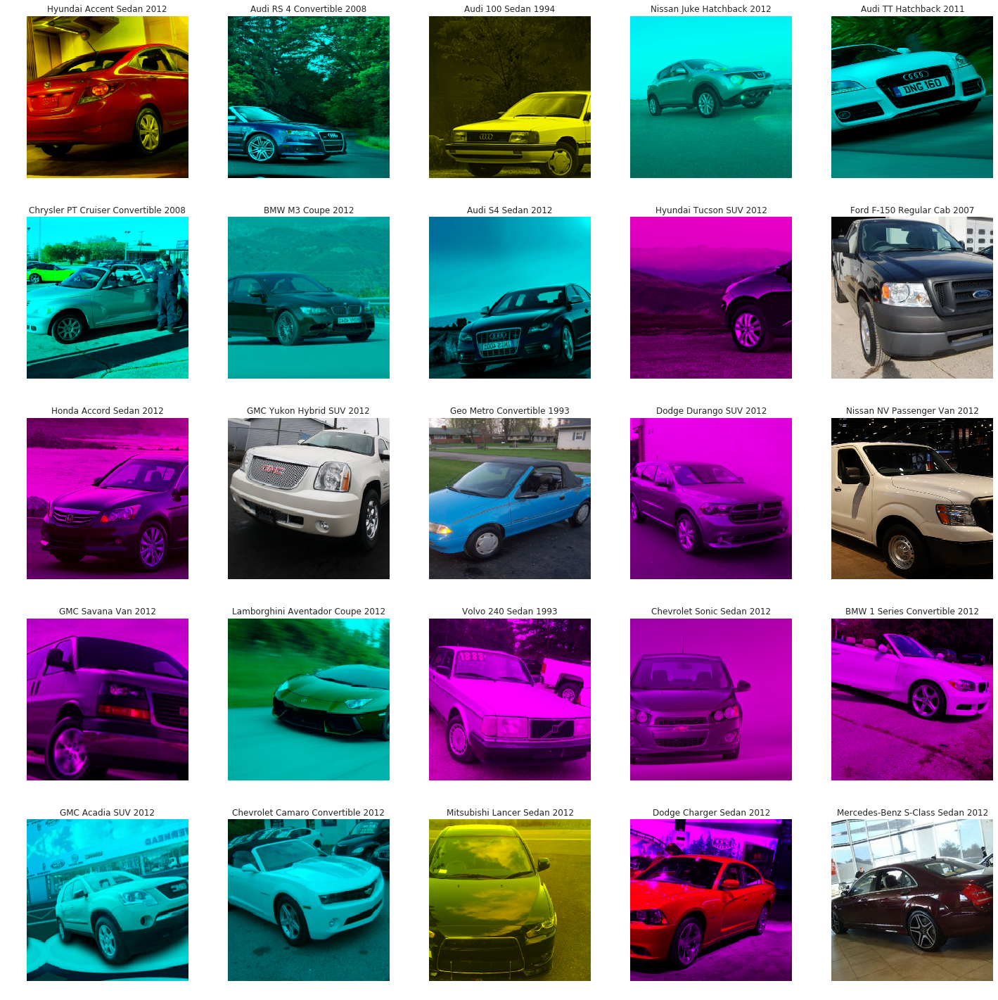

In [140]:
data, src, car_tfms = get_data(rgb_tweak(thresh=0.75))
data.show_batch()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


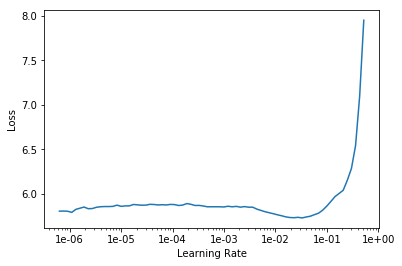

In [77]:
data, src, car_tfms = get_data(rgb_tweak(t=0.75))
data.batch_size = 26

arch = models.resnet152

learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])

learn.lr_find()
learn.recorder.plot()

In [44]:
arch = models.resnet152
data, src, car_tfms = get_data(rgb_tweak(t=0.75))
data.batch_size = 128

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 5 different models so that we can average the validation accuracy
for i in range(0,3):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)

# Save the model and the metrics
learn.save(f't2_p0.75_rgb_aug_{lr}_40e')

t2_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
t2_rgb_aug.to_csv('t2_p0.75_rgb_aug.csv')

epoch,train_loss,valid_loss,accuracy,time
0,5.312233,4.305844,0.100123,01:10
1,4.429006,3.282020,0.284398,01:11
2,3.495407,2.343801,0.463145,01:10
3,2.609745,1.752348,0.554668,01:11
4,1.984750,1.601786,0.565725,01:11
5,1.684456,1.797907,0.523956,01:10
6,1.605141,2.585335,0.396192,01:11
7,1.583581,2.789751,0.393735,01:11
8,1.528108,2.625541,0.412162,01:11
9,1.480046,2.120569,0.477273,01:11


epoch,train_loss,valid_loss,accuracy,time
0,5.313631,4.320460,0.122236,01:11
1,4.424989,3.324588,0.245086,01:11
2,3.518710,2.292521,0.462531,01:11
3,2.648754,1.733943,0.547297,01:11
4,1.986636,1.752072,0.525184,01:11
5,1.686478,2.300492,0.423219,01:10
6,1.585724,2.287621,0.444717,01:10
7,1.598573,2.738151,0.396192,01:10
8,1.580618,2.154813,0.457617,01:10
9,1.505793,3.001125,0.355037,01:11


epoch,train_loss,valid_loss,accuracy,time
0,5.292726,4.311561,0.109951,01:10
1,4.379069,3.263026,0.261057,01:11
2,3.452423,2.271232,0.455774,01:12
3,2.581087,1.688782,0.563882,01:10
4,1.987074,1.754542,0.515971,01:12
5,1.672879,2.080788,0.479115,01:11
6,1.563829,2.594342,0.405405,01:12
7,1.610879,2.324029,0.441646,01:12
8,1.574745,2.144521,0.476658,01:11
9,1.503502,2.756445,0.375307,01:10


In [45]:
# Tidy up the data for nice plotting
base = t2_rgb_aug.transpose()
tmp_ls = []
acc_ls = []

for i,v in enumerate(base[0]):
    for j in v:
        tmp_ls.append(j[0].numpy().item())
    acc_ls.append(tmp_ls)
    tmp_ls = []
    
t2_acc_df = pd.DataFrame(acc_ls).transpose()
t2_acc_df.to_csv('t2_accuracy.csv')
t2_acc_df.head()

,0,1,2
0,0.100123,0.122236,0.109951
1,0.284398,0.245086,0.261057
2,0.463145,0.462531,0.455774
3,0.554668,0.547297,0.563882
4,0.565725,0.525184,0.515971


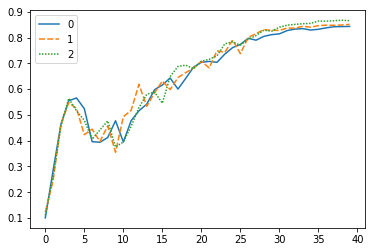

In [46]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=t2_acc_df)

## Test 2.2 - 99% zeroed out

In [47]:
arch = models.resnet152
data, src, car_tfms = get_data(rgb_tweak(t=0.99))
data.batch_size = 128

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 5 different models so that we can average the validation accuracy
for i in range(0,3):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)

# Save the model and the metrics
learn.save(f't22_p0.75_rgb_aug_{lr}_40e')

t22_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
t22_rgb_aug.to_csv('t22_p0.75_rgb_aug.csv')

epoch,train_loss,valid_loss,accuracy,time
0,5.216179,4.223863,0.123464,01:12
1,4.280709,3.247795,0.295455,01:10
2,3.332711,2.291939,0.471744,01:10
3,2.468405,1.737056,0.570025,01:11
4,1.879493,1.758797,0.517813,01:10
5,1.566268,2.033508,0.488329,01:12
6,1.518569,2.636073,0.377150,01:12
7,1.507390,2.352579,0.440418,01:12
8,1.517006,1.947570,0.504914,01:10
9,1.474219,2.882621,0.407248,01:11


epoch,train_loss,valid_loss,accuracy,time
0,5.240950,4.236574,0.131450,01:12
1,4.294129,3.228648,0.304054,01:11
2,3.348625,2.266263,0.479115,01:11
3,2.477107,1.770711,0.533784,01:10
4,1.870089,1.815826,0.521499,01:10
5,1.570423,2.270365,0.447174,01:11
6,1.515885,3.329643,0.328010,01:10
7,1.514689,3.120276,0.340295,01:10
8,1.524870,2.300653,0.437961,01:11
9,1.438842,1.901181,0.514128,01:11


epoch,train_loss,valid_loss,accuracy,time
0,5.162923,4.141847,0.127764,01:11
1,4.215477,3.163963,0.333538,01:11
2,3.302109,2.249794,0.483415,01:11
3,2.452599,1.706870,0.565725,01:11
4,1.860644,1.932706,0.489558,01:11
5,1.571359,1.965712,0.496314,01:11
6,1.509569,3.005657,0.308968,01:13
7,1.531541,2.090405,0.474201,01:10
8,1.543531,2.476551,0.418919,01:11
9,1.446106,3.249862,0.333538,01:10


In [48]:
# Tidy up the data for nice plotting
base = t22_rgb_aug.transpose()
tmp_ls = []
acc_ls = []

for i,v in enumerate(base[0]):
    for j in v:
        tmp_ls.append(j[0].numpy().item())
    acc_ls.append(tmp_ls)
    tmp_ls = []
    
t22_acc_df = pd.DataFrame(acc_ls).transpose()
t22_acc_df.to_csv('t22_accuracy.csv')
t22_acc_df.head()

,0,1,2
0,0.123464,0.131450,0.127764
1,0.295455,0.304054,0.333538
2,0.471744,0.479115,0.483415
3,0.570025,0.533784,0.565725
4,0.517813,0.521499,0.489558


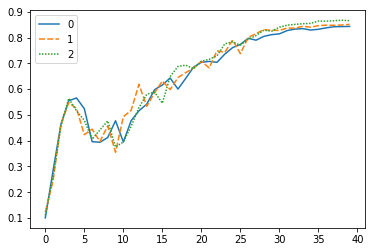

In [49]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=t2_acc_df)

## Compile initial results

In [154]:
full = pd.concat([base_acc_df, acc_df, acc75_df], axis=1)
cols = []
for i in range(0,5):
    cols.append('b_'+str(i+1))
for i in range(0,5):
    cols.append('aug_0.5_' + str(i+1))
for i in range(0,5):
    cols.append('aug_0.75_' + str(i+1))
    
full.columns = cols  
full.head()

,b_1,b_2,b_3,b_4,b_5,aug_0.5_1,aug_0.5_2,aug_0.5_3,aug_0.5_4,aug_0.5_5,aug_0.75_1,aug_0.75_2,aug_0.75_3,aug_0.75_4,aug_0.75_5
0,0.269656,0.216830,0.263514,0.283170,0.212531,0.291155,0.234644,0.185504,0.258600,0.232801,0.229115,0.202703,0.163391,0.211916,0.224816
1,0.472359,0.421990,0.433047,0.422604,0.414005,0.441646,0.395577,0.427518,0.457002,0.382064,0.396806,0.459459,0.378993,0.421990,0.483415
2,0.514742,0.512899,0.526413,0.518427,0.509828,0.557740,0.499386,0.522727,0.524570,0.565111,0.494472,0.523342,0.531327,0.486486,0.453931
3,0.556511,0.612408,0.574939,0.606880,0.590909,0.590909,0.557125,0.568182,0.589066,0.614251,0.562039,0.570025,0.571867,0.547297,0.567568
4,0.589066,0.600123,0.630835,0.630221,0.586609,0.572482,0.644963,0.570025,0.576167,0.620393,0.580467,0.598894,0.581695,0.615479,0.579238


In [158]:
full.to_csv('color_aug_acc_results-base-0.5-0.75.csv')

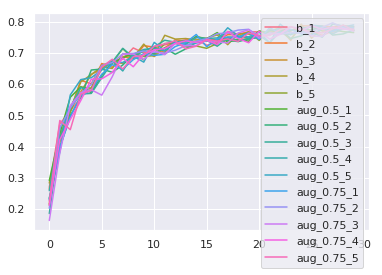

In [155]:
ax = sns.lineplot(data=full, dashes=False)

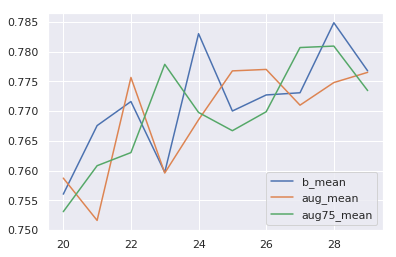

In [157]:
b_mean = full.iloc[:,:5].mean(axis=1)
aug_mean = full.iloc[:,5:10].mean(axis=1)
aug75_mean = full.iloc[:,10:].mean(axis=1)

full_mean = pd.concat([b_mean,aug_mean,aug75_mean], axis=1)
full_mean.columns = ['b_mean', 'aug_mean', 'aug75_mean']
ax = sns.lineplot(data=full_mean.tail(10), dashes=False)

In [142]:
full_mean.tail(5)

,b_mean,aug_mean
25,0.770025,0.776781
26,0.772727,0.777027
27,0.773096,0.771007
28,0.784889,0.774816
29,0.776781,0.776536


## 4. Test 3 Use Random Noise, 50% prob
NOTE: only ran for 3 iterations!

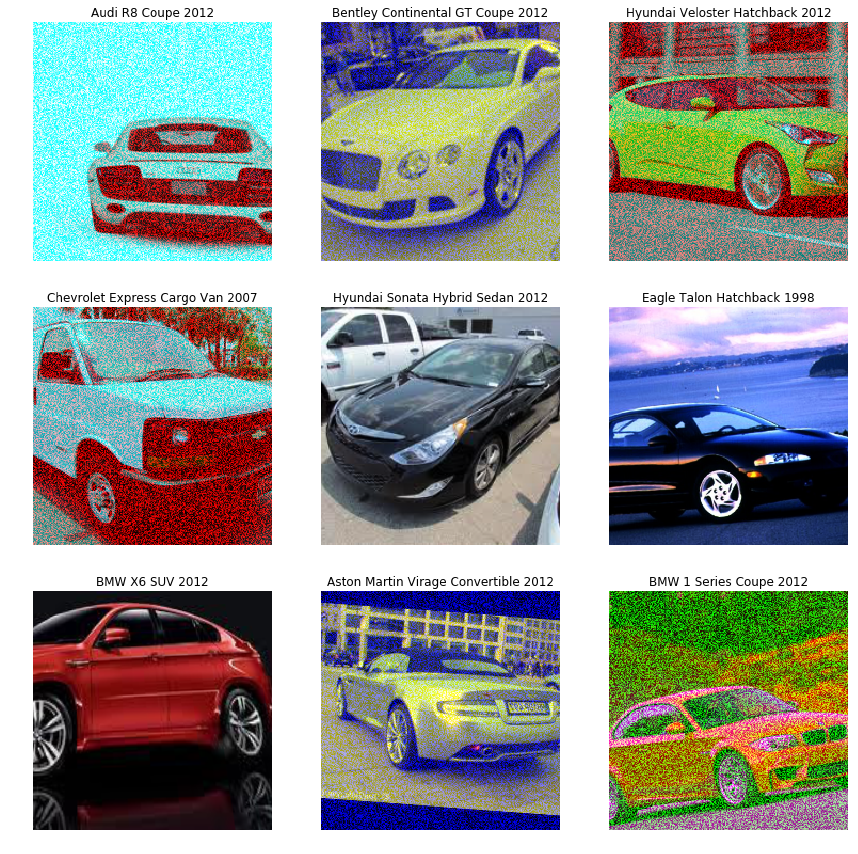

In [70]:
data, src, car_tfms = get_data(rgb_tweak_rand(t=0.5))
data.show_batch(rows=3)

In [7]:
arch = models.resnet152
data, src, car_tfms = get_data(rgb_tweak_rand(t=0.5))
data.batch_size = 128

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 5 different models so that we can average the validation accuracy
for i in range(0,3):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)

# Save the model and the metrics
learn.save(f't3_p0.5_rgb_aug_{lr}_40e')

t3_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
t3_rgb_aug.to_csv('t3_p0.5_rgb_aug.csv')

epoch,train_loss,valid_loss,accuracy,time
0,5.536534,4.640962,0.063268,01:20
1,5.027240,3.740649,0.202703,01:12
2,4.293810,2.812708,0.337224,01:12
3,3.452559,2.058716,0.479115,01:12
4,2.756767,2.044697,0.459459,01:10
5,2.360009,1.966188,0.472359,01:11
6,2.201892,2.913193,0.337224,01:10
7,2.109291,2.439255,0.408477,01:12
8,2.045759,2.198679,0.458845,01:11
9,1.965587,2.354924,0.419533,01:10


epoch,train_loss,valid_loss,accuracy,time
0,5.539282,4.601370,0.080467,01:11
1,4.946236,3.724300,0.175061,01:12
2,4.190997,2.834413,0.328010,01:12
3,3.386178,2.142314,0.460688,01:11
4,2.722837,1.966819,0.469902,01:11
5,2.337859,2.125098,0.450860,01:11
6,2.178438,2.042988,0.454545,01:10
7,2.138299,2.085828,0.443489,01:11
8,2.038187,2.445529,0.415233,01:12
9,1.967525,2.278794,0.443489,01:12


epoch,train_loss,valid_loss,accuracy,time
0,5.595592,4.641993,0.067568,01:11
1,5.016047,3.747515,0.198403,01:11
2,4.259167,2.840492,0.329853,01:10
3,3.423102,2.128696,0.447789,01:11
4,2.764833,1.981357,0.461916,01:13
5,2.377201,2.369797,0.391892,01:11
6,2.214495,2.558089,0.373464,01:11
7,2.121855,2.581097,0.390049,01:11
8,2.068220,2.154222,0.454545,01:10
9,1.957569,2.082459,0.474201,01:11


In [8]:
# Tidy up the data for nice plotting
base = t3_rgb_aug.transpose()
tmp_ls = []
acc_ls = []

for i,v in enumerate(base[0]):
    for j in v:
        tmp_ls.append(j[0].numpy().item())
    acc_ls.append(tmp_ls)
    tmp_ls = []
    
t3_acc_df = pd.DataFrame(acc_ls).transpose()
t3_acc_df.to_csv('t3_accuracy.csv')
t3_acc_df.head()

,0,1,2
0,0.063268,0.080467,0.067568
1,0.202703,0.175061,0.198403
2,0.337224,0.328010,0.329853
3,0.479115,0.460688,0.447789
4,0.459459,0.469902,0.461916


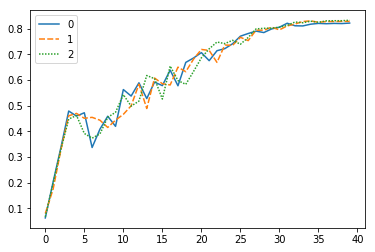

In [9]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=t3_acc_df)

## 4b. Test 3.2 Use Random Noise, 30% prob
NOTE: only ran for 3 iterations!

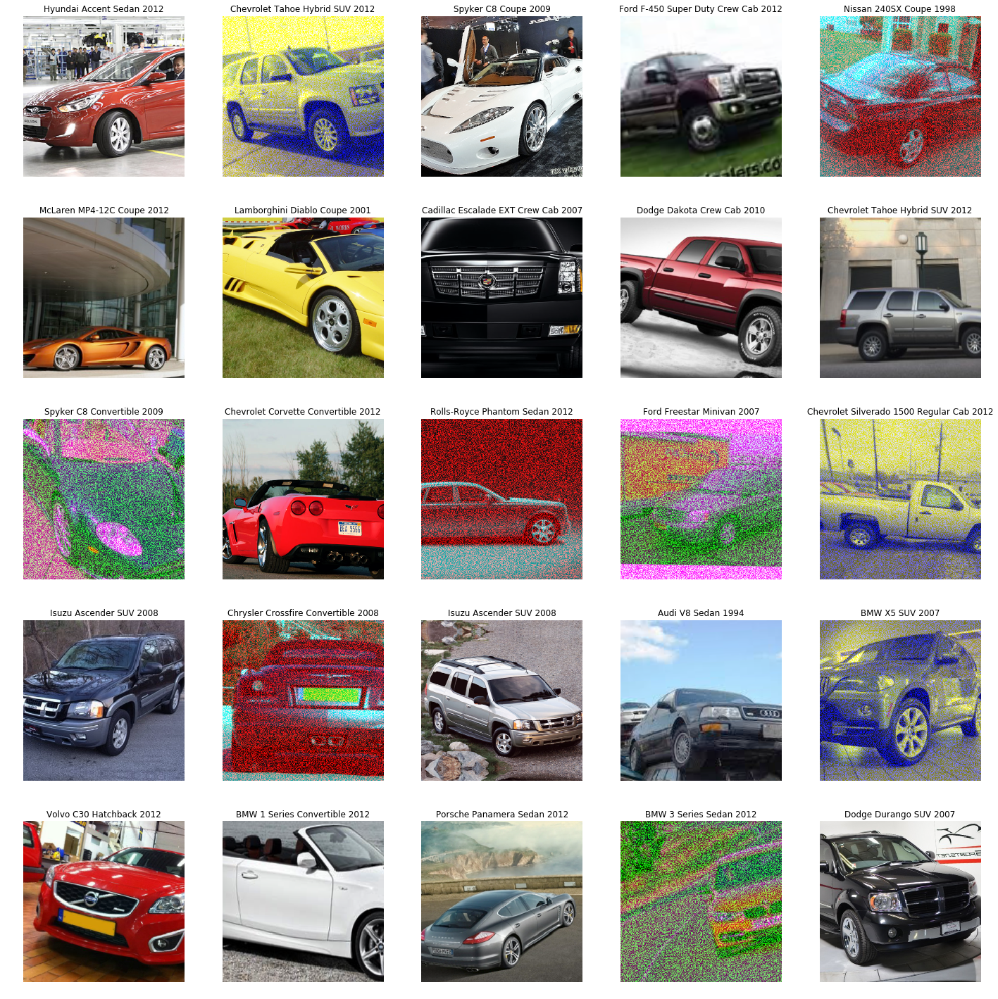

In [10]:
data, src, car_tfms = get_data(rgb_tweak_rand(t=0.3))
data.show_batch()

In [11]:
arch = models.resnet152
data, src, car_tfms = get_data(rgb_tweak_rand(t=0.3))
data.batch_size = 128

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 5 different models so that we can average the validation accuracy
for i in range(0,3):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)

# Save the model and the metrics
learn.save(f't32_p0.5_rgb_aug_{lr}_40e')

t32_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
t32_rgb_aug.to_csv('t32_p0.5_rgb_aug.csv')

epoch,train_loss,valid_loss,accuracy,time
0,5.456309,4.454073,0.090909,01:11
1,4.736461,3.472446,0.240172,01:12
2,3.894852,2.560849,0.410319,01:11
3,3.084241,1.918487,0.521499,01:11
4,2.431743,1.854409,0.503071,01:10
5,2.106760,1.954256,0.485872,01:12
6,2.019674,1.813989,0.519656,01:10
7,1.975164,2.618421,0.380221,01:11
8,1.913232,2.518178,0.415233,01:10
9,1.876131,2.197210,0.453931,01:10


epoch,train_loss,valid_loss,accuracy,time
0,5.485043,4.383615,0.101966,01:10
1,4.779621,3.433811,0.248772,01:10
2,3.929751,2.527081,0.387592,01:11
3,3.104272,1.853404,0.516585,01:11
4,2.466310,1.776694,0.527027,01:10
5,2.151774,1.927055,0.492629,01:11
6,1.997122,2.245431,0.423219,01:10
7,1.961454,2.732385,0.377764,01:10
8,1.904500,2.462857,0.421376,01:11
9,1.836449,2.923298,0.356880,01:10


epoch,train_loss,valid_loss,accuracy,time
0,5.426170,4.413448,0.094595,01:12
1,4.734072,3.427860,0.256142,01:13
2,3.929278,2.543351,0.401720,01:10
3,3.090608,1.960524,0.493243,01:13
4,2.450154,1.977461,0.489558,01:11
5,2.142179,1.995627,0.455160,01:11
6,2.003082,2.155268,0.469287,01:12
7,1.957787,2.466845,0.418919,01:12
8,1.923162,2.432624,0.424447,01:11
9,1.826007,1.968529,0.503685,01:12


In [12]:
# Tidy up the data for nice plotting
base = t32_rgb_aug.transpose()
tmp_ls = []
acc_ls = []

for i,v in enumerate(base[0]):
    for j in v:
        tmp_ls.append(j[0].numpy().item())
    acc_ls.append(tmp_ls)
    tmp_ls = []
    
t32_acc_df = pd.DataFrame(acc_ls).transpose()
t32_acc_df.to_csv('t32_accuracy.csv')
t32_acc_df.head()

,0,1,2
0,0.090909,0.101966,0.094595
1,0.240172,0.248772,0.256142
2,0.410319,0.387592,0.401720
3,0.521499,0.516585,0.493243
4,0.503071,0.527027,0.489558


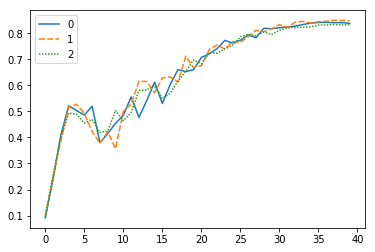

In [13]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=t32_acc_df)

## 5. Test 4 - Use rgb_randomize from fastai

In [15]:
t = 0.3

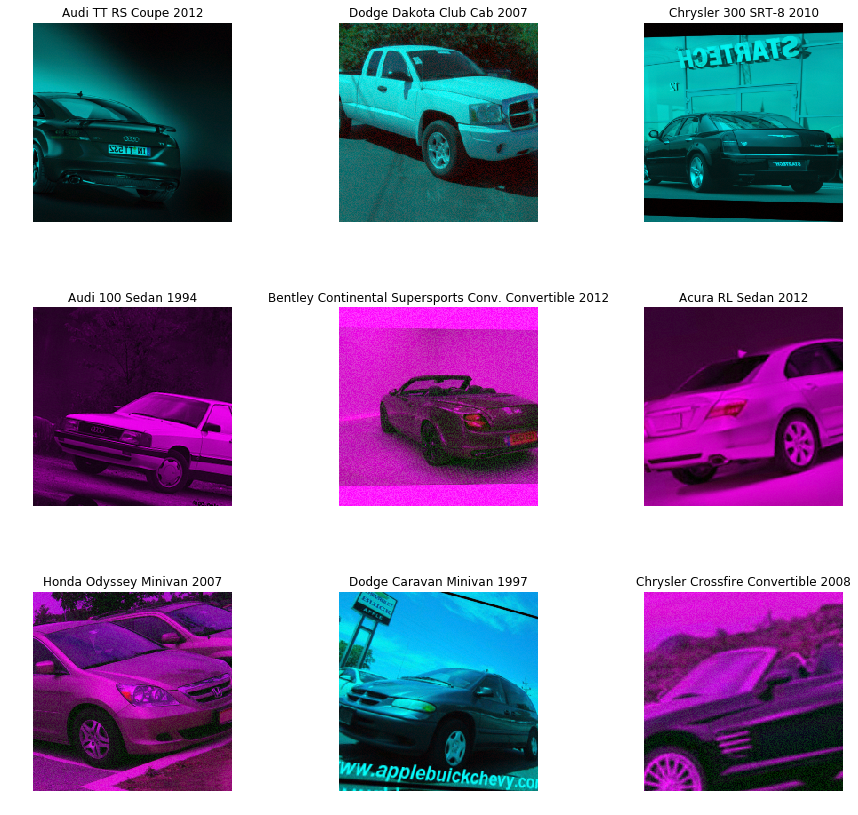

In [16]:
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.show_batch(rows = 3)

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


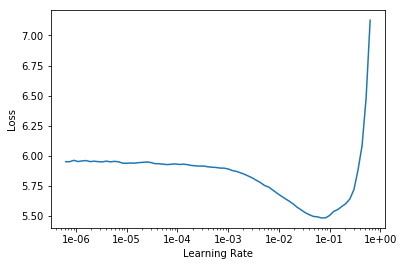

In [17]:
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.batch_size = 128

arch = models.resnet152

learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])

learn.lr_find()
learn.recorder.plot()

In [18]:
arch = models.resnet152
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.batch_size = 128

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 5 different models so that we can average the validation accuracy
for i in range(0,3):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)

# Save the model and the metrics
learn.save(f't4_t{t}_rgb_aug_{lr}_40e')

t4_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
t4_rgb_aug.to_csv('t4_t{t}_rgb_aug_{lr}.csv')

epoch,train_loss,valid_loss,accuracy,time
0,5.459715,4.667096,0.059582,01:20
1,4.697430,3.648781,0.207617,01:18
2,3.821324,2.672521,0.380221,01:16
3,2.946197,1.916276,0.514128,01:17
4,2.264487,1.765460,0.528256,01:19
5,1.933733,2.332804,0.433047,01:19
6,1.808564,2.887486,0.331081,01:20
7,1.812790,2.719023,0.399877,01:20
8,1.733428,3.466960,0.309582,01:19
9,1.673860,1.931054,0.501229,01:18


epoch,train_loss,valid_loss,accuracy,time
0,5.468096,4.652462,0.062654,01:18
1,4.676932,3.637964,0.190418,01:21
2,3.785225,2.728289,0.375921,01:20
3,2.926212,2.025379,0.482801,01:48
4,2.250766,2.280961,0.417690,01:44
5,1.918598,2.429533,0.417690,01:59
6,1.795218,2.534779,0.377764,01:46
7,1.798066,2.962666,0.329853,02:17
8,1.742171,7.096694,0.308968,02:04
9,1.699820,2.217796,0.459459,01:41


epoch,train_loss,valid_loss,accuracy,time
0,5.442544,4.614820,0.071253,01:18
1,4.644893,3.641218,0.195946,01:21
2,3.767855,2.665954,0.379607,01:19
3,2.892874,2.049972,0.463145,01:18
4,2.270486,1.810602,0.512285,01:20
5,1.940613,2.000701,0.474816,01:18
6,1.816373,2.541826,0.389435,01:16
7,1.812653,2.351373,0.420762,01:19
8,1.734748,2.194569,0.480344,02:06
9,1.663100,2.081635,0.492629,01:39


In [19]:
# Tidy up the data for nice plotting
base = t4_rgb_aug.transpose()
tmp_ls = []
acc_ls = []

for i,v in enumerate(base[0]):
    for j in v:
        tmp_ls.append(j[0].numpy().item())
    acc_ls.append(tmp_ls)
    tmp_ls = []
    
t4_acc_df = pd.DataFrame(acc_ls).transpose()
t4_acc_df.to_csv('t4_accuracy.csv')
t4_acc_df.head()

,0,1,2
0,0.059582,0.062654,0.071253
1,0.207617,0.190418,0.195946
2,0.380221,0.375921,0.379607
3,0.514128,0.482801,0.463145
4,0.528256,0.417690,0.512285


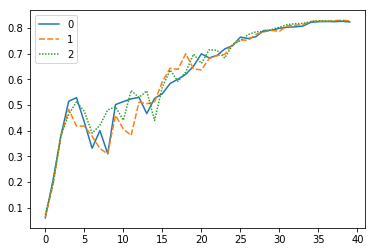

In [20]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=t4_acc_df)

## 6. Test 5 - 50% threshold

In [7]:
t = 0.5

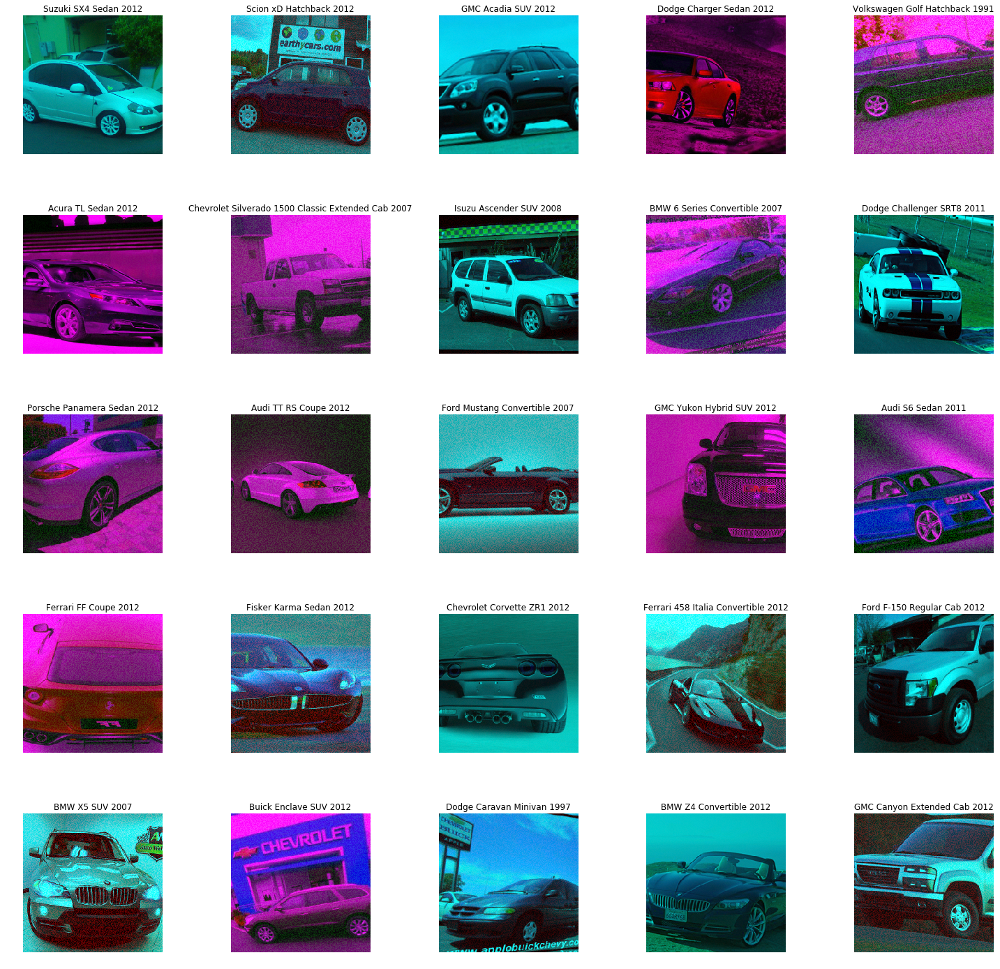

In [19]:
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.show_batch()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


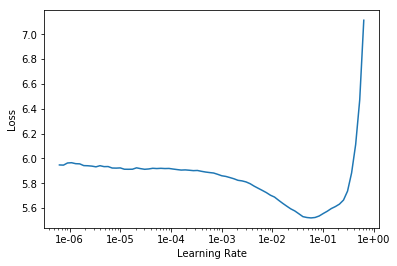

In [20]:
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.batch_size = 128

arch = models.resnet152

learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])

learn.lr_find()
learn.recorder.plot()

In [8]:
arch = models.resnet152
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.batch_size = 128

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 5 different models so that we can average the validation accuracy
for i in range(0,3):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)

# Save the model and the metrics
learn.save(f't5_t{t}_rgb_aug_{lr}_40e')

t5_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
t5_rgb_aug.to_csv('t5_t{t}_rgb_aug_{lr}.csv')

epoch,train_loss,valid_loss,accuracy,time
0,5.500396,4.813272,0.046683,01:17
1,4.832078,3.906317,0.160319,01:11
2,4.008679,2.893990,0.326781,01:10
3,3.144937,2.235186,0.431818,01:12
4,2.442369,2.028353,0.470516,01:10
5,2.109237,2.544632,0.379607,01:11
6,1.945640,2.270226,0.436118,01:09
7,1.913249,2.184770,0.436118,01:11
8,1.865057,3.248893,0.334152,01:10
9,1.777281,2.397314,0.425061,01:10


epoch,train_loss,valid_loss,accuracy,time
0,5.540011,4.825846,0.044226,01:11
1,4.867082,3.895725,0.151106,01:10
2,4.032999,2.870540,0.322482,01:11
3,3.161505,2.069655,0.492015,01:10
4,2.477457,1.872301,0.492015,01:11
5,2.072438,2.271373,0.404177,01:11
6,1.938261,2.333460,0.427518,01:10
7,1.906507,2.864658,0.322482,01:10
8,1.837368,2.500121,0.397420,01:10
9,1.762968,2.304400,0.429975,01:11


epoch,train_loss,valid_loss,accuracy,time
0,5.517395,4.813580,0.060197,01:10
1,4.846960,3.872707,0.165848,01:10
2,4.034825,2.904677,0.328010,01:10
3,3.156163,2.061020,0.485258,01:12
4,2.455544,2.179885,0.450246,01:11
5,2.078722,2.655668,0.378993,01:11
6,1.956028,2.481174,0.423219,01:12
7,1.913460,2.294703,0.445332,01:10
8,1.847253,2.574337,0.390663,01:11
9,1.761586,2.338454,0.426904,01:10


In [ ]:
# Tidy up the data for nice plotting
base = t5_rgb_aug.transpose()
tmp_ls = []
acc_ls = []

for i,v in enumerate(base[0]):
    for j in v:
        tmp_ls.append(j[0].numpy().item())
    acc_ls.append(tmp_ls)
    tmp_ls = []
    
t5_acc_df = pd.DataFrame(acc_ls).transpose()
t5_acc_df.to_csv('t5_accuracy.csv')
t5_acc_df.head()

,0,1,2
0,0.046683,0.044226,0.060197
1,0.160319,0.151106,0.165848
2,0.326781,0.322482,0.328010
3,0.431818,0.492015,0.485258
4,0.470516,0.492015,0.450246


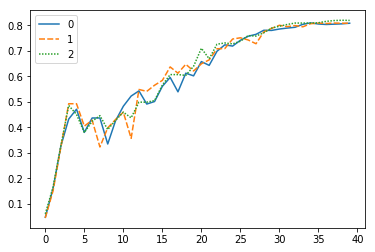

In [ ]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=t5_acc_df)

## 7. Test 6 - 80% threshold

In [ ]:
t = 0.8

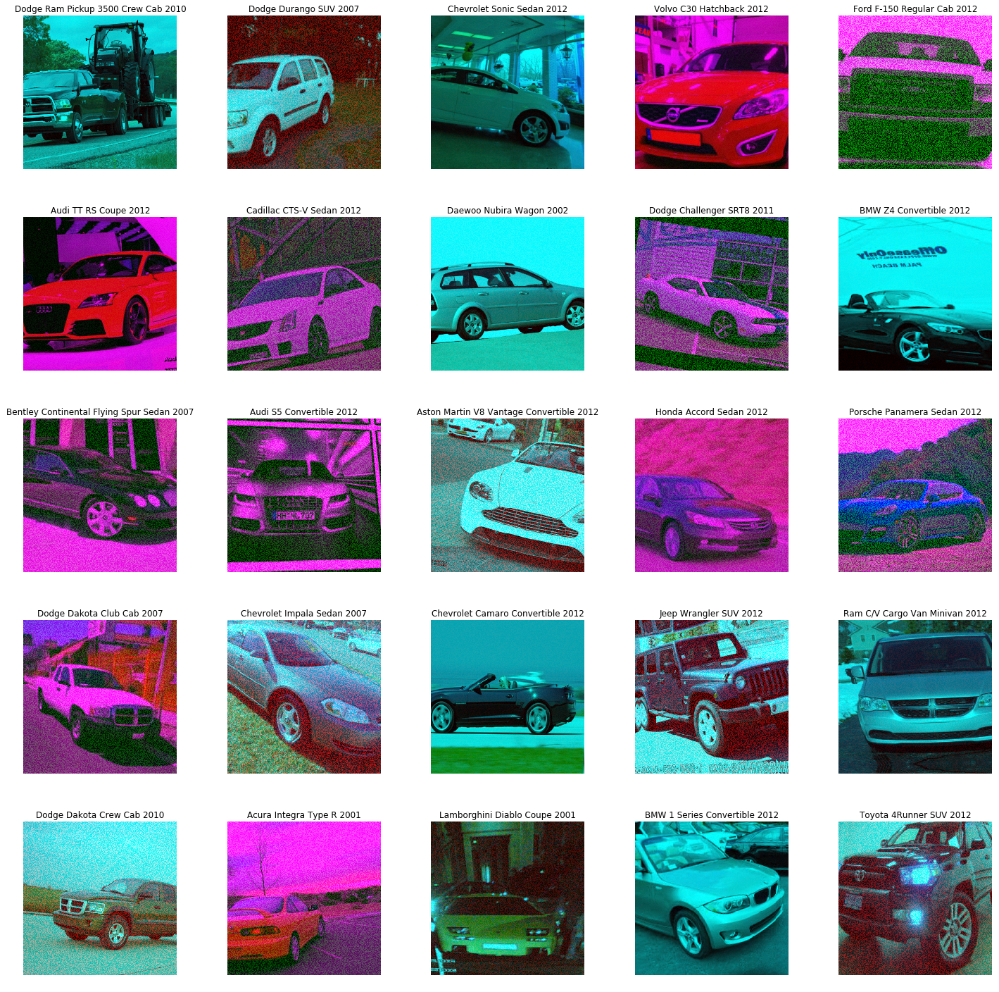

In [ ]:
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.show_batch()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


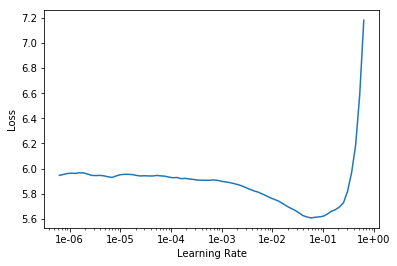

In [ ]:
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.batch_size = 128

arch = models.resnet152

learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])

learn.lr_find()
learn.recorder.plot()

In [ ]:
arch = models.resnet152
data, src, car_tfms = get_data(rgb_randomize(thresh=t))
data.batch_size = 128

trn_accuracy_ls = [] 
val_losses_ls = [] 
trn_losses_ls = [] 

# Train a 5 different models so that we can average the validation accuracy
for i in range(0,3):
    learn = cnn_learner(data, base_arch =  arch, metrics=[accuracy])   
    lr = 1e-2
    learn.fit_one_cycle(40, max_lr = lr)

    trn_accuracy_ls.append(learn.recorder.metrics)
    val_losses_ls.append(learn.recorder.val_losses)
    trn_losses_ls.append(learn.recorder.losses)

# Save the model and the metrics
learn.save(f't6_t{t}_rgb_aug_{lr}_40e')

t6_rgb_aug = pd.DataFrame([trn_accuracy_ls,
                            val_losses_ls,
                            trn_losses_ls])
t6_rgb_aug.to_csv('t6_t{t}_rgb_aug_{lr}.csv')

epoch,train_loss,valid_loss,accuracy,time
0,5.607993,5.000741,0.030098,01:12
1,4.995857,4.126682,0.110565,01:11
2,4.225146,3.083970,0.300369,01:11
3,3.400458,2.318656,0.414619,01:11
4,2.692811,2.048491,0.457617,01:11
5,2.316192,2.433798,0.377764,01:10
6,2.150510,3.330481,0.348894,01:10
7,2.088460,3.424461,0.306511,01:10
8,2.000614,2.076971,0.470516,01:12
9,1.928651,2.556611,0.387592,01:11


epoch,train_loss,valid_loss,accuracy,time
0,5.585908,4.985181,0.039926,01:12
1,4.999704,4.105443,0.116093,01:11
2,4.204886,3.044592,0.277027,01:10
3,3.367301,2.205420,0.427518,01:11
4,2.691519,1.935063,0.484029,01:11
5,2.320468,2.517433,0.374693,01:12
6,2.152420,2.363937,0.410934,01:12
7,2.060470,3.136497,0.334152,01:12
8,1.995077,2.465151,0.401720,01:13
9,1.892162,2.135998,0.450860,01:14


epoch,train_loss,valid_loss,accuracy,time
0,5.606047,4.956154,0.031941,01:11
1,5.022507,4.184494,0.121007,01:11
2,4.246645,3.156935,0.283784,01:10
3,3.402365,2.315128,0.434275,01:11
4,2.712693,2.126756,0.445332,01:10
5,2.305346,2.752429,0.330467,01:11
6,2.153803,3.090460,0.344595,01:12
7,2.093484,2.846524,0.356265,01:10
8,1.996429,3.014676,0.344595,01:10
9,1.870160,3.210786,0.313268,01:11


In [ ]:
# Tidy up the data for nice plotting
base = t6_rgb_aug.transpose()
tmp_ls = []
acc_ls = []

for i,v in enumerate(base[0]):
    for j in v:
        tmp_ls.append(j[0].numpy().item())
    acc_ls.append(tmp_ls)
    tmp_ls = []
    
t6_acc_df = pd.DataFrame(acc_ls).transpose()
t6_acc_df.to_csv('t6_accuracy.csv')
t6_acc_df.head()

,0,1,2
0,0.030098,0.039926,0.031941
1,0.110565,0.116093,0.121007
2,0.300369,0.277027,0.283784
3,0.414619,0.427518,0.434275
4,0.457617,0.484029,0.445332


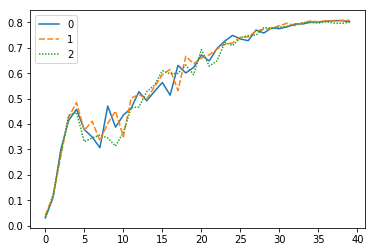

In [ ]:
# Plot the accuracy of the baseline training runs
ax = sns.lineplot(data=t6_acc_df)

# Compile All Results
<a id='results'></a>
[Back to top](#top)

In [4]:
t1_acc_df = pd.read_csv('t1_p0.5_rgb_aug_accuracy.csv')

t2_acc_df = pd.read_csv('t2_accuracy.csv')

t22_acc_df = pd.read_csv('t22_accuracy.csv')

t3_acc_df = pd.read_csv('t3_accuracy.csv')

t32_acc_df = pd.read_csv('t32_accuracy.csv')

t4_acc_df = pd.read_csv('t4_accuracy.csv')

t5_acc_df = pd.read_csv('t5_accuracy.csv')

t6_acc_df = pd.read_csv('t6_accuracy.csv')

base2_acc_df = pd.read_csv('base2_accuracy.csv')

In [5]:
acc_mean = [t1_acc_df.iloc[:,1:].mean(axis=1)[30:],
            t2_acc_df.iloc[:,1:].mean(axis=1)[30:],
            t22_acc_df.iloc[:,1:].mean(axis=1)[30:],
            t3_acc_df.iloc[:,1:].mean(axis=1)[30:],
            t32_acc_df.iloc[:,1:].mean(axis=1)[30:],
            t4_acc_df.iloc[:,1:].mean(axis=1)[30:],
            t5_acc_df.iloc[:,1:].mean(axis=1)[30:],
            t6_acc_df.iloc[:,1:].mean(axis=1)[30:],
            base2_acc_df.iloc[:,1:].mean(axis=1)[30:]]

In [13]:
cols = ['rgb_tweak(t=0.5)', 
        'rgb_tweak(t=0.75))', 
        'rgb_tweak(t=0.99)', 
        'rgb_tweak_rand(t=0.5)',
        'rgb_tweak_rand(t=0.3)',
        'rgb_randomize(thresh=0.3)',
        'rgb_randomize(thresh=0.5)',
        'rgb_randomize(thresh=0.8)', 
        'baseline']
acc_mean_df = pd.DataFrame(acc_mean).transpose()
acc_mean_df.columns = cols
acc_mean_df.head()

,rgb_tweak(t=0.5),rgb_tweak(t=0.75)),rgb_tweak(t=0.99),rgb_tweak_rand(t=0.5),rgb_tweak_rand(t=0.3),rgb_randomize(thresh=0.3),rgb_randomize(thresh=0.5),rgb_randomize(thresh=0.8),baseline
30,0.81720,0.827600,0.825553,0.801802,0.822072,0.796069,0.793612,0.781122,0.820229
31,0.82286,0.837633,0.831286,0.814292,0.822482,0.807740,0.795250,0.787879,0.829034
32,0.83132,0.840295,0.832924,0.817977,0.830876,0.810197,0.799550,0.789926,0.829238
33,0.83074,0.844185,0.839271,0.820025,0.834152,0.812654,0.801802,0.796888,0.833538
34,0.83798,0.841523,0.841523,0.825143,0.834562,0.823505,0.807740,0.802007,0.837428


In [14]:
acc_mean_df.to_csv('rgb_testing_val_acc_results.csv')

In [55]:
plt.style.use('seaborn-colorblind')
pylab.rcParams['axes.facecolor'] = '#fafafa'
pylab.rcParams['figure.facecolor'] = '#fafafa'

pylab.rcParams['figure.figsize'] = 15, 7

# font = {'family' : 'normal',
#         'weight' : 'normal',
#         'size'   : 14}
# pylab.rc('font', **font)

Text(23.89,0.5,'Validation Accuracy')

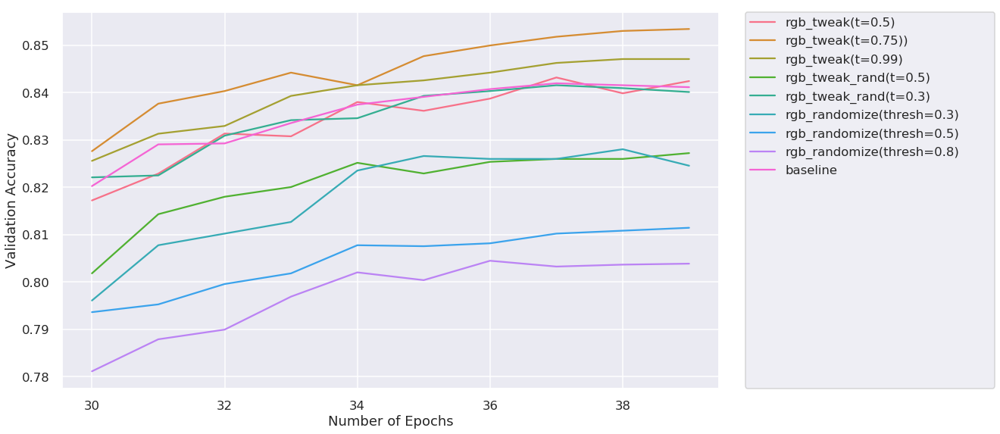

In [46]:
sns.set()
style.use('seaborn-colorblind')
sns.set_context('talk')
fig, ax = pyplot.subplots(figsize=(14,8))
ax = sns.lineplot(data=acc_mean_df, dashes=False)

leg = legend(bbox_to_anchor=(1.04,0.0,0.38,1), loc="lower left",
                borderaxespad=0, mode='expand')

plt.tight_layout(rect=[0,0,1.0,1])

# do this after calling tight layout or changing axes positions in any way:
fontsize = fig.canvas.get_renderer().points_to_pixels(leg._fontsize)
pad = 2 * (leg.borderaxespad + leg.borderpad) * fontsize
leg._legend_box.set_height(leg.get_bbox_to_anchor().height-pad)

xlabel('Number of Epochs')
ylabel('Validation Accuracy')